# Decision Tree - Deposit Subcribing Prediction

## 1. Import Modules and Data

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay, accuracy_score

For this notebook we will use the <a href="https://archive.ics.uci.edu/dataset/222/bank+marketing" >Bank Marketing [Dataset]. UCI Machine Learning Repository</a>, the classification goal is to predict if the client will subscribe (yes/no) a term deposit, with features such as job, education, loan,... 

In [3]:
pd.set_option('display.max_columns', None)  # Hiện tất cả cột


In [4]:
df = pd.read_csv("bank.csv")

In [5]:
df.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,deposit
0,59,admin.,married,secondary,no,2343,yes,no,unknown,5,may,1042,1,-1,0,unknown,yes
1,56,admin.,married,secondary,no,45,no,no,unknown,5,may,1467,1,-1,0,unknown,yes
2,41,technician,married,secondary,no,1270,yes,no,unknown,5,may,1389,1,-1,0,unknown,yes
3,55,services,married,secondary,no,2476,yes,no,unknown,5,may,579,1,-1,0,unknown,yes
4,54,admin.,married,tertiary,no,184,no,no,unknown,5,may,673,2,-1,0,unknown,yes


In [6]:
df.tail()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,deposit
11157,33,blue-collar,single,primary,no,1,yes,no,cellular,20,apr,257,1,-1,0,unknown,no
11158,39,services,married,secondary,no,733,no,no,unknown,16,jun,83,4,-1,0,unknown,no
11159,32,technician,single,secondary,no,29,no,no,cellular,19,aug,156,2,-1,0,unknown,no
11160,43,technician,married,secondary,no,0,no,yes,cellular,8,may,9,2,172,5,failure,no
11161,34,technician,married,secondary,no,0,no,no,cellular,9,jul,628,1,-1,0,unknown,no


## 2. Preprocessing

After loading the data, the first step is always to get an idea of what the data looks like and how it's structured. That should give us an idea on how to clean it, as well as what models to use. 

## Data exploration

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11162 entries, 0 to 11161
Data columns (total 17 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   age        11162 non-null  int64 
 1   job        11162 non-null  object
 2   marital    11162 non-null  object
 3   education  11162 non-null  object
 4   default    11162 non-null  object
 5   balance    11162 non-null  int64 
 6   housing    11162 non-null  object
 7   loan       11162 non-null  object
 8   contact    11162 non-null  object
 9   day        11162 non-null  int64 
 10  month      11162 non-null  object
 11  duration   11162 non-null  int64 
 12  campaign   11162 non-null  int64 
 13  pdays      11162 non-null  int64 
 14  previous   11162 non-null  int64 
 15  poutcome   11162 non-null  object
 16  deposit    11162 non-null  object
dtypes: int64(7), object(10)
memory usage: 1.4+ MB


1. The "info" function tells us that there are no NULL values in dataset
2. Only 7 features are numerical
3. 10 features are categorical

## Encode data

In [8]:
df['deposit'] = df['deposit'].replace({'yes': 1, 'no': 0})
df['deposit'].head()

C:\Users\VINH\AppData\Local\Temp\ipykernel_11888\4170051603.py:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df['deposit'] = df['deposit'].replace({'yes': 1, 'no': 0})


0    1
1    1
2    1
3    1
4    1
Name: deposit, dtype: int64

In [9]:
df['loan'] = df['loan'].replace({'yes': 1, 'no': 0})
df.head()

C:\Users\VINH\AppData\Local\Temp\ipykernel_11888\1915311639.py:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df['loan'] = df['loan'].replace({'yes': 1, 'no': 0})


,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,deposit
0,59,admin.,married,secondary,no,2343,yes,0,unknown,5,may,1042,1,-1,0,unknown,1
1,56,admin.,married,secondary,no,45,no,0,unknown,5,may,1467,1,-1,0,unknown,1
2,41,technician,married,secondary,no,1270,yes,0,unknown,5,may,1389,1,-1,0,unknown,1
3,55,services,married,secondary,no,2476,yes,0,unknown,5,may,579,1,-1,0,unknown,1
4,54,admin.,married,tertiary,no,184,no,0,unknown,5,may,673,2,-1,0,unknown,1


In [10]:
df['default'] = df['default'].replace({'yes': 1, 'no': 0})
df.head()

C:\Users\VINH\AppData\Local\Temp\ipykernel_11888\1375337725.py:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df['default'] = df['default'].replace({'yes': 1, 'no': 0})


,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,deposit
0,59,admin.,married,secondary,0,2343,yes,0,unknown,5,may,1042,1,-1,0,unknown,1
1,56,admin.,married,secondary,0,45,no,0,unknown,5,may,1467,1,-1,0,unknown,1
2,41,technician,married,secondary,0,1270,yes,0,unknown,5,may,1389,1,-1,0,unknown,1
3,55,services,married,secondary,0,2476,yes,0,unknown,5,may,579,1,-1,0,unknown,1
4,54,admin.,married,tertiary,0,184,no,0,unknown,5,may,673,2,-1,0,unknown,1


In [11]:
df['housing'] = df['housing'].replace({'yes': 1, 'no': 0})
df.head()

C:\Users\VINH\AppData\Local\Temp\ipykernel_11888\2880570166.py:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df['housing'] = df['housing'].replace({'yes': 1, 'no': 0})


,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,deposit
0,59,admin.,married,secondary,0,2343,1,0,unknown,5,may,1042,1,-1,0,unknown,1
1,56,admin.,married,secondary,0,45,0,0,unknown,5,may,1467,1,-1,0,unknown,1
2,41,technician,married,secondary,0,1270,1,0,unknown,5,may,1389,1,-1,0,unknown,1
3,55,services,married,secondary,0,2476,1,0,unknown,5,may,579,1,-1,0,unknown,1
4,54,admin.,married,tertiary,0,184,0,0,unknown,5,may,673,2,-1,0,unknown,1


In [12]:
one_hot = pd.get_dummies(df['marital'], prefix='marital')
df = df.drop('marital',axis = 1)
df = df.join(one_hot)

In [13]:
df.head()


,age,job,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,deposit,marital_divorced,marital_married,marital_single
0,59,admin.,secondary,0,2343,1,0,unknown,5,may,1042,1,-1,0,unknown,1,False,True,False
1,56,admin.,secondary,0,45,0,0,unknown,5,may,1467,1,-1,0,unknown,1,False,True,False
2,41,technician,secondary,0,1270,1,0,unknown,5,may,1389,1,-1,0,unknown,1,False,True,False
3,55,services,secondary,0,2476,1,0,unknown,5,may,579,1,-1,0,unknown,1,False,True,False
4,54,admin.,tertiary,0,184,0,0,unknown,5,may,673,2,-1,0,unknown,1,False,True,False


In [14]:
one_hot = pd.get_dummies(df['education'], prefix='education')
df = df.drop('education',axis = 1)
df = df.join(one_hot)
df.head()

,age,job,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,deposit,marital_divorced,marital_married,marital_single,education_primary,education_secondary,education_tertiary,education_unknown
0,59,admin.,0,2343,1,0,unknown,5,may,1042,1,-1,0,unknown,1,False,True,False,False,True,False,False
1,56,admin.,0,45,0,0,unknown,5,may,1467,1,-1,0,unknown,1,False,True,False,False,True,False,False
2,41,technician,0,1270,1,0,unknown,5,may,1389,1,-1,0,unknown,1,False,True,False,False,True,False,False
3,55,services,0,2476,1,0,unknown,5,may,579,1,-1,0,unknown,1,False,True,False,False,True,False,False
4,54,admin.,0,184,0,0,unknown,5,may,673,2,-1,0,unknown,1,False,True,False,False,False,True,False


In [15]:
one_hot = pd.get_dummies(df['job'], prefix='job')
df = df.drop('job',axis = 1)
df = df.join(one_hot)
df.head()

,age,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,deposit,marital_divorced,marital_married,marital_single,education_primary,education_secondary,education_tertiary,education_unknown,job_admin.,job_blue-collar,job_entrepreneur,job_housemaid,job_management,job_retired,job_self-employed,job_services,job_student,job_technician,job_unemployed,job_unknown
0,59,0,2343,1,0,unknown,5,may,1042,1,-1,0,unknown,1,False,True,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False
1,56,0,45,0,0,unknown,5,may,1467,1,-1,0,unknown,1,False,True,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False
2,41,0,1270,1,0,unknown,5,may,1389,1,-1,0,unknown,1,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,True,False,False
3,55,0,2476,1,0,unknown,5,may,579,1,-1,0,unknown,1,False,True,False,False,True,False,False,False,False,False,False,False,False,False,True,False,False,False,False
4,54,0,184,0,0,unknown,5,may,673,2,-1,0,unknown,1,False,True,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,False,False


In [ ]:
one_hot = pd.get_dummies(df['contact'], prefix='contact')
df = df.drop('contact',axis = 1)
df = df.join(one_hot)
df.head()

,age,default,balance,housing,loan,day,month,duration,campaign,pdays,previous,poutcome,deposit,marital_divorced,marital_married,marital_single,education_primary,education_secondary,education_tertiary,education_unknown,job_admin.,job_blue-collar,job_entrepreneur,job_housemaid,job_management,job_retired,job_self-employed,job_services,job_student,job_technician,job_unemployed,job_unknown,contact_cellular,contact_telephone,contact_unknown
0,59,0,2343,1,0,5,may,1042,1,-1,0,unknown,1,False,True,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True
1,56,0,45,0,0,5,may,1467,1,-1,0,unknown,1,False,True,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True
2,41,0,1270,1,0,5,may,1389,1,-1,0,unknown,1,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True
3,55,0,2476,1,0,5,may,579,1,-1,0,unknown,1,False,True,False,False,True,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True
4,54,0,184,0,0,5,may,673,2,-1,0,unknown,1,False,True,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True


In [17]:
one_hot = pd.get_dummies(df['month'], prefix='month')
df = df.drop('month',axis = 1)
df = df.join(one_hot)
df.head()

,age,default,balance,housing,loan,day,duration,campaign,pdays,previous,poutcome,deposit,marital_divorced,marital_married,marital_single,education_primary,education_secondary,education_tertiary,education_unknown,job_admin.,job_blue-collar,job_entrepreneur,job_housemaid,job_management,job_retired,job_self-employed,job_services,job_student,job_technician,job_unemployed,job_unknown,contact_cellular,contact_telephone,contact_unknown,month_apr,month_aug,month_dec,month_feb,month_jan,month_jul,month_jun,month_mar,month_may,month_nov,month_oct,month_sep
0,59,0,2343,1,0,5,1042,1,-1,0,unknown,1,False,True,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False
1,56,0,45,0,0,5,1467,1,-1,0,unknown,1,False,True,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False
2,41,0,1270,1,0,5,1389,1,-1,0,unknown,1,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False
3,55,0,2476,1,0,5,579,1,-1,0,unknown,1,False,True,False,False,True,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False
4,54,0,184,0,0,5,673,2,-1,0,unknown,1,False,True,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False


In [18]:
one_hot = pd.get_dummies(df['poutcome'], prefix='poutcome')
df = df.drop('poutcome',axis = 1)
df = df.join(one_hot)
df.head()

,age,default,balance,housing,loan,day,duration,campaign,pdays,previous,deposit,marital_divorced,marital_married,marital_single,education_primary,education_secondary,education_tertiary,education_unknown,job_admin.,job_blue-collar,job_entrepreneur,job_housemaid,job_management,job_retired,job_self-employed,job_services,job_student,job_technician,job_unemployed,job_unknown,contact_cellular,contact_telephone,contact_unknown,month_apr,month_aug,month_dec,month_feb,month_jan,month_jul,month_jun,month_mar,month_may,month_nov,month_oct,month_sep,poutcome_failure,poutcome_other,poutcome_success,poutcome_unknown
0,59,0,2343,1,0,5,1042,1,-1,0,1,False,True,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True
1,56,0,45,0,0,5,1467,1,-1,0,1,False,True,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True
2,41,0,1270,1,0,5,1389,1,-1,0,1,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True
3,55,0,2476,1,0,5,579,1,-1,0,1,False,True,False,False,True,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True
4,54,0,184,0,0,5,673,2,-1,0,1,False,True,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True


In [19]:
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11162 entries, 0 to 11161
Data columns (total 49 columns):
 #   Column               Non-Null Count  Dtype
---  ------               --------------  -----
 0   age                  11162 non-null  int64
 1   default              11162 non-null  int64
 2   balance              11162 non-null  int64
 3   housing              11162 non-null  int64
 4   loan                 11162 non-null  int64
 5   day                  11162 non-null  int64
 6   duration             11162 non-null  int64
 7   campaign             11162 non-null  int64
 8   pdays                11162 non-null  int64
 9   previous             11162 non-null  int64
 10  deposit              11162 non-null  int64
 11  marital_divorced     11162 non-null  bool 
 12  marital_married      11162 non-null  bool 
 13  marital_single       11162 non-null  bool 
 14  education_primary    11162 non-null  bool 
 15  education_secondary  11162 non-null  bool 
 16  education_tertiary   1

## Split data into dependent and independent variables

In [20]:
X = df.drop('deposit', axis=1)
y = df['deposit']

print(f"Dataset shape: {X.shape}, Label distribution:\n{y.value_counts()}")

Dataset shape: (11162, 48), Label distribution:
deposit
0    5873
1    5289
Name: count, dtype: int64


In [21]:
df.head()

,age,default,balance,housing,loan,day,duration,campaign,pdays,previous,deposit,marital_divorced,marital_married,marital_single,education_primary,education_secondary,education_tertiary,education_unknown,job_admin.,job_blue-collar,job_entrepreneur,job_housemaid,job_management,job_retired,job_self-employed,job_services,job_student,job_technician,job_unemployed,job_unknown,contact_cellular,contact_telephone,contact_unknown,month_apr,month_aug,month_dec,month_feb,month_jan,month_jul,month_jun,month_mar,month_may,month_nov,month_oct,month_sep,poutcome_failure,poutcome_other,poutcome_success,poutcome_unknown
0,59,0,2343,1,0,5,1042,1,-1,0,1,False,True,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True
1,56,0,45,0,0,5,1467,1,-1,0,1,False,True,False,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True
2,41,0,1270,1,0,5,1389,1,-1,0,1,False,True,False,False,True,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True
3,55,0,2476,1,0,5,579,1,-1,0,1,False,True,False,False,True,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True
4,54,0,184,0,0,5,673,2,-1,0,1,False,True,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,True


## 3. Prepare Train/Test Splits

In [22]:
subsets = []
split_ratios = [0.4, 0.6, 0.8, 0.9] 

In [23]:
for ratio in split_ratios:
    X_train, X_test, y_train, y_test = train_test_split(
        X, y, train_size=ratio, stratify=y, shuffle=True, random_state=42
    )
    subsets.append((X_train, X_test, y_train, y_test))

## Visualize label distribution

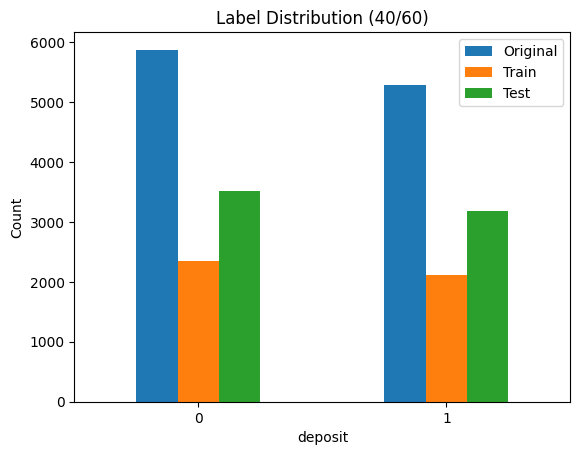

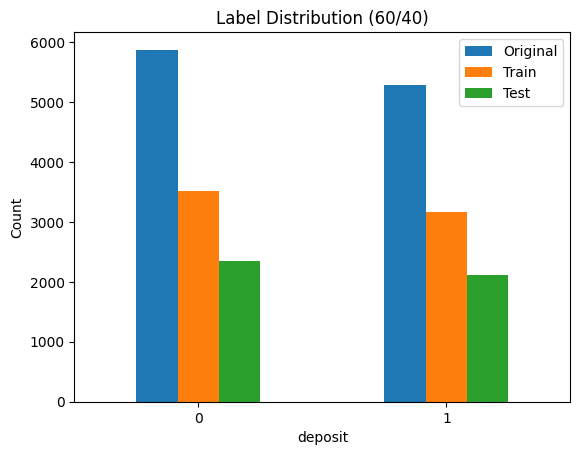

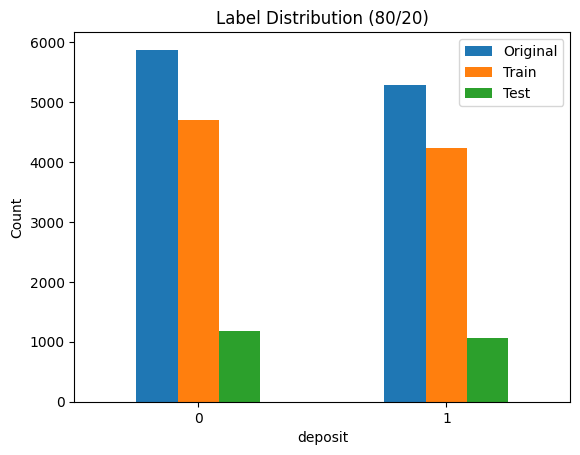

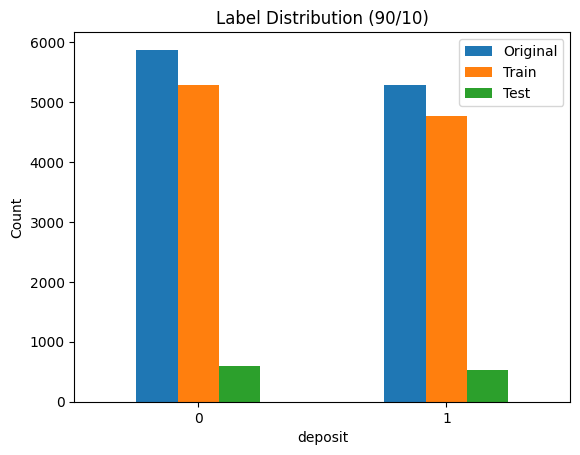

In [24]:
def plot_label_distribution(y_original, y_train, y_test, title):
    counts = pd.DataFrame({
        'Original': pd.Series(y_original).value_counts(),
        'Train': pd.Series(y_train).value_counts(),
        'Test': pd.Series(y_test).value_counts()
    })
    counts.plot(kind='bar', rot=0)
    plt.title(title)
    plt.ylabel('Count')
    plt.show()

for idx, (X_train, X_test, y_train, y_test) in enumerate(subsets):
    title = f"Label Distribution ({int(split_ratios[idx]*100)}/{int(100-split_ratios[idx]*100)})"
    plot_label_distribution(y, y_train, y_test, title)

## 4. Train Decision Trees

## Building the decision tree classifiers

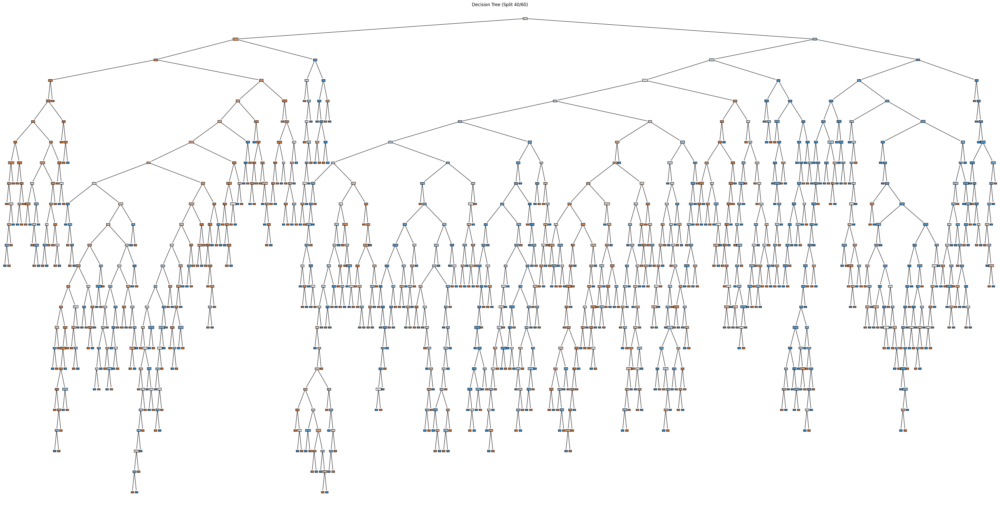

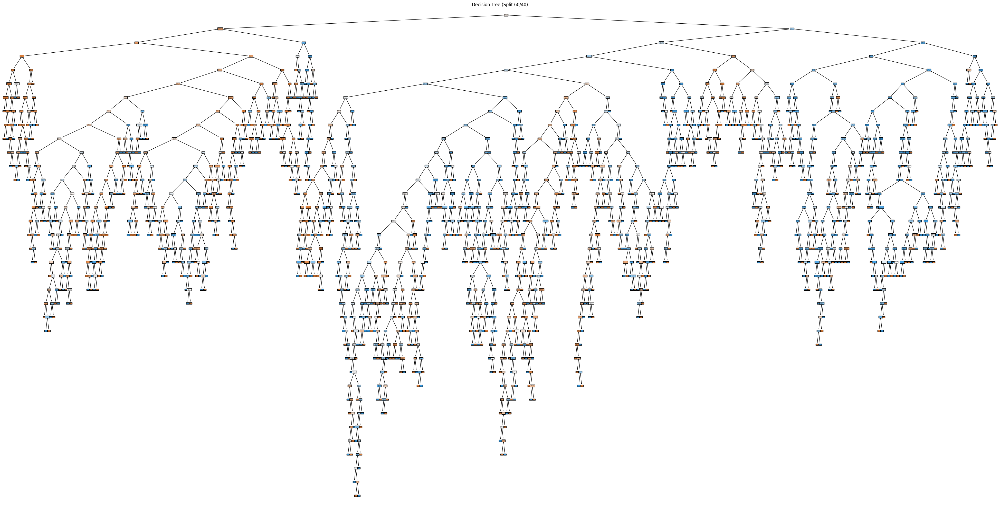

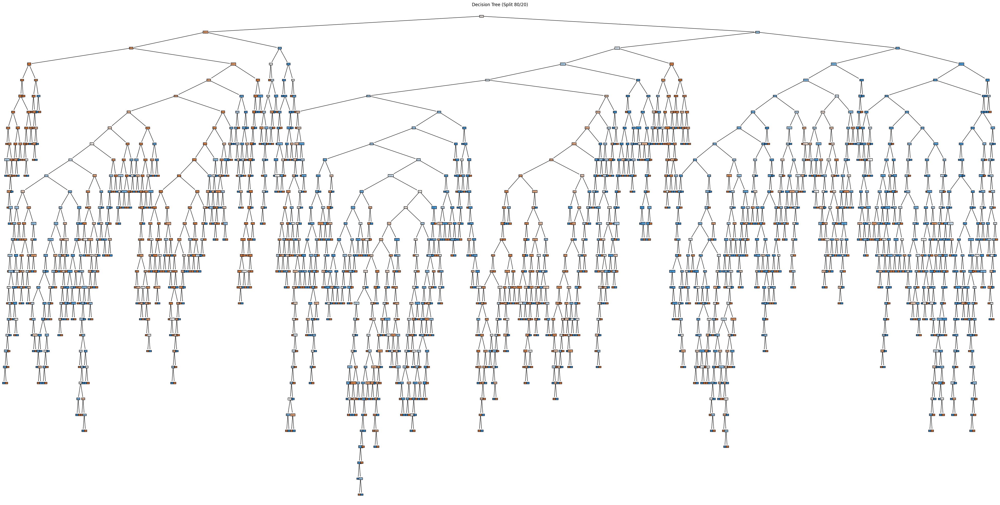

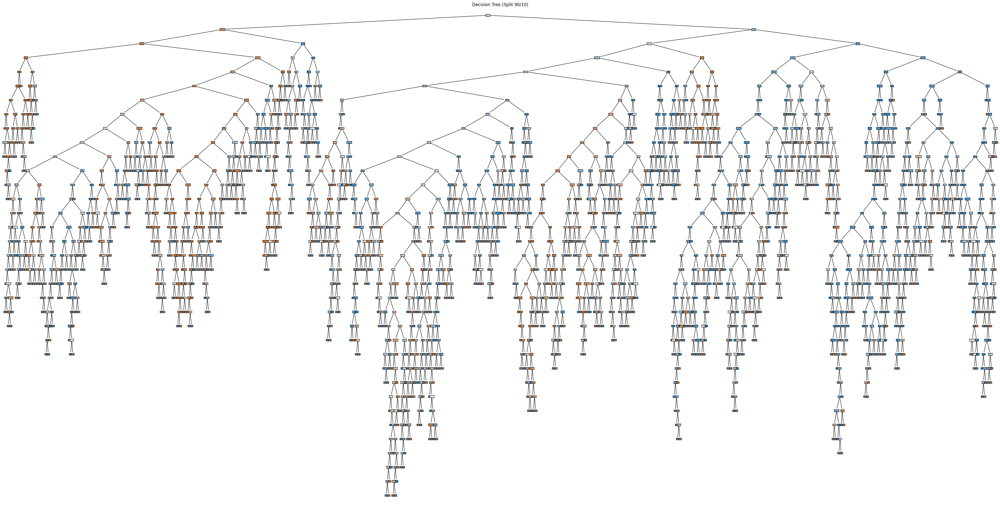

In [25]:
trees = []

for idx, (X_train, X_test, y_train, y_test) in enumerate(subsets):
    clf = DecisionTreeClassifier(criterion='entropy', random_state=42)
    clf.fit(X_train, y_train)
    trees.append((clf, X_train, X_test, y_train, y_test))

    # Plot tree (first none levels)
    plt.figure(figsize=(50,25))
    plot_tree(clf, feature_names=X.columns, class_names=['no','yes'], filled=True, max_depth=None)
    plt.title(f"Decision Tree (Split {int(split_ratios[idx]*100)}/{int(100-split_ratios[idx]*100)})")
    plt.show()

## 5. Evaluating the decision tree classifiers

###  Evaluation Metrics Formulas:

- **Precision**:
  $$
  \text{Precision} = \frac{TP}{TP + FP}
  $$

- **Recall**:
  $$
  \text{Recall} = \frac{TP}{TP + FN}
  $$

- **F1-Score**:
  $$
  F1 = 2 \times \frac{\text{Precision} \times \text{Recall}}{\text{Precision} + \text{Recall}}
  $$

- **Accuracy**:
  $$
  \text{Accuracy} = \frac{\text{Number of Correct Predictions}}{\text{Total Number of Samples}}
  $$


=== Evaluation for split 40/60 ===
              precision    recall  f1-score   support

          no       0.78      0.79      0.79      3524
         yes       0.77      0.76      0.76      3174

    accuracy                           0.78      6698
   macro avg       0.78      0.77      0.78      6698
weighted avg       0.78      0.78      0.78      6698



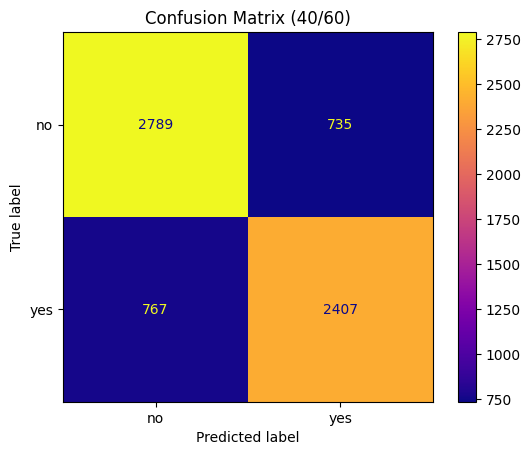

=== Evaluation for split 60/40 ===
              precision    recall  f1-score   support

          no       0.78      0.79      0.78      2349
         yes       0.76      0.75      0.76      2116

    accuracy                           0.77      4465
   macro avg       0.77      0.77      0.77      4465
weighted avg       0.77      0.77      0.77      4465



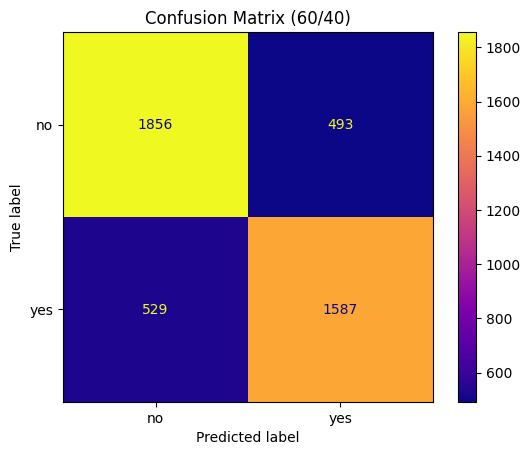

=== Evaluation for split 80/20 ===
              precision    recall  f1-score   support

          no       0.80      0.81      0.81      1175
         yes       0.79      0.78      0.79      1058

    accuracy                           0.80      2233
   macro avg       0.80      0.80      0.80      2233
weighted avg       0.80      0.80      0.80      2233



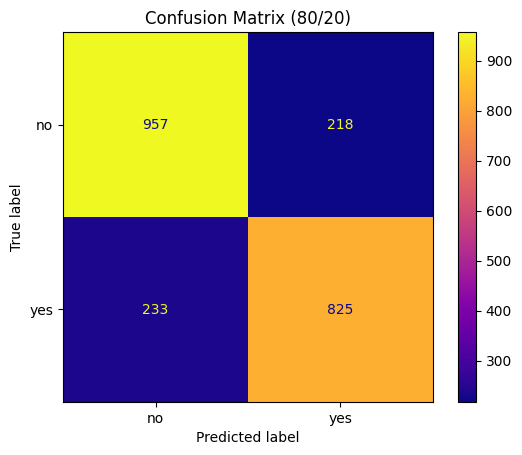

=== Evaluation for split 90/10 ===
              precision    recall  f1-score   support

          no       0.79      0.80      0.80       588
         yes       0.78      0.76      0.77       529

    accuracy                           0.79      1117
   macro avg       0.78      0.78      0.78      1117
weighted avg       0.79      0.79      0.79      1117



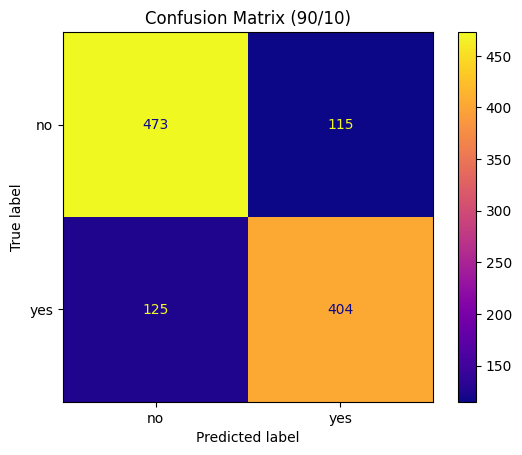

In [26]:
for idx, (clf, X_train, X_test, y_train, y_test) in enumerate(trees):
    y_pred = clf.predict(X_test)
    print(f"=== Evaluation for split {int(split_ratios[idx]*100)}/{int(100-split_ratios[idx]*100)} ===")
    print(classification_report(y_test, y_pred, target_names=['no', 'yes']))

    disp = ConfusionMatrixDisplay(confusion_matrix(y_test, y_pred), display_labels=['no', 'yes'])
    disp.plot(cmap='plasma')
    plt.title(f"Confusion Matrix ({int(split_ratios[idx]*100)}/{int(100-split_ratios[idx]*100)})")
    plt.show()

## 6. The depth and accuracy of a decision tree

We will visualize how the depth of the decision tree affects classification accuracy focus on 80/20 training and test sets

In [27]:
X_train, X_test, y_train, y_test = subsets[2]  # 80/20 split

depths = [None, 2, 3, 4, 5, 6, 7]
accuracies = []

## Train decision trees on the 80/20 split dataset with varying depths.

In [ ]:
for depth in depths:
    clf = DecisionTreeClassifier(criterion='entropy', max_depth=depth, random_state=42)
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)
    acc = accuracy_score(y_test, y_pred)
    accuracies.append(acc)

    plt.figure(figsize=(50,25))
    plot_tree(clf, feature_names=X.columns, class_names = ['no','yes'], filled=True)
    plt.title(f"Decision Tree with max_depth={depth}")
    plt.show()

## Line chart between accuracy and max_depth

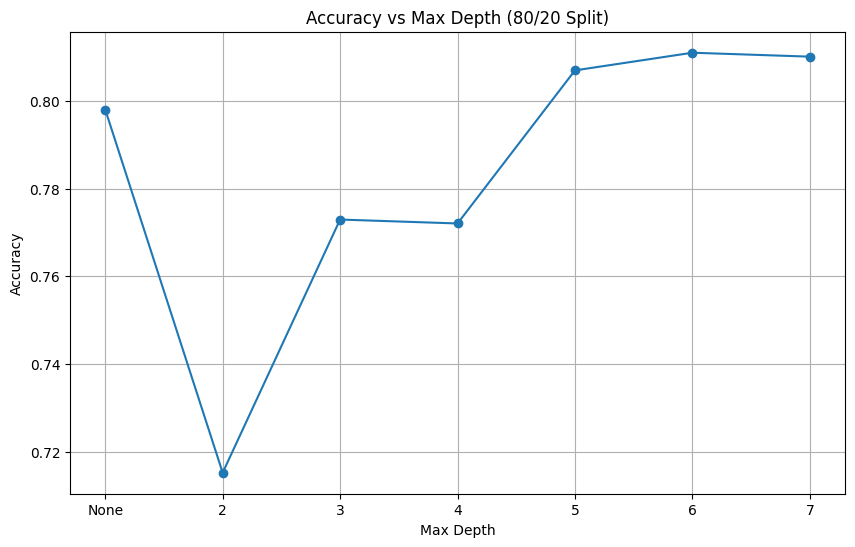

In [29]:
plt.figure(figsize=(10,6))
plt.plot(['None', 2, 3, 4, 5, 6, 7], accuracies, marker='o')
plt.title("Accuracy vs Max Depth (80/20 Split)")
plt.xlabel("Max Depth")
plt.ylabel("Accuracy")
plt.grid(True)
plt.show()

## Print accuracy table

In [30]:
print("\nAccuracy by max_depth:")
for d, acc in zip(['None',2,3,4,5,6,7], accuracies):
    print(f"Depth {d}: {acc:.4f}")


Accuracy by max_depth:
Depth None: 0.7980
Depth 2: 0.7152
Depth 3: 0.7730
Depth 4: 0.7721
Depth 5: 0.8070
Depth 6: 0.8110
Depth 7: 0.8101
